# CycleGAN

### Goals
In this notebook, you will write a generative model based on the paper [*Unpaired Image-to-Image Translation
using Cycle-Consistent Adversarial Networks*](https://arxiv.org/abs/1703.10593) by Zhu et al. 2017, commonly referred to as CycleGAN.

You will be training a model that can convert horses into zebras, and vice versa. Once again, the emphasis of the assignment will be on the loss functions. In order for you to see good outputs more quickly, you'll be training your model starting from a pre-trained checkpoint. You are also welcome to train it from scratch on your own, if you so choose.


<!-- You will take the segmentations that you generated in the previous assignment and produce photorealistic images. -->

### Learning Objectives
1.   Implement the loss functions of a CycleGAN model.
2.   Observe the two GANs used in CycleGAN.



## Getting Started
You will start by importing libraries, defining a visualization function, and getting the pre-trained CycleGAN checkpoint.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import glob
import random
import os
from torch.utils.data import Dataset
from PIL import Image
import sys

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    image_tensor = (image_tensor + 1) / 2
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()


class ImageDataset(Dataset):
    def __init__(self, root, transform=None, mode='training'):
        self.transform = transform
        self.files_A = sorted(glob.glob(os.path.join(root, 'data/training_real') + '/*.*'))
        self.files_B = sorted(glob.glob(os.path.join(root, 'data/anime1') + '/*.*'))
        if len(self.files_A) > len(self.files_B):
            self.files_A, self.files_B = self.files_B, self.files_A
        self.new_perm()
        assert len(self.files_A) > 0, "Make sure you have data!"
        print(f'You have {len(self.files_A)} real faces and {len(self.files_B)} anime faces')

    def new_perm(self):
        self.randperm = torch.randperm(len(self.files_B))[:len(self.files_A)]

    def __getitem__(self, index):
        item_A = self.transform(Image.open(self.files_A[index % len(self.files_A)]))[:3]
        item_B = self.transform(Image.open(self.files_B[self.randperm[index]]))[:3]
        if item_A.shape[0] != 3: 
            item_A = item_A.repeat(3, 1, 1)
        if item_B.shape[0] != 3: 
            item_B = item_B.repeat(3, 1, 1)
        if index == len(self) - 1:
            self.new_perm()
        # Old versions of PyTorch didn't support normalization for different-channeled images
        return (item_A - 0.5) * 2, (item_B - 0.5) * 2

    def __len__(self):
        return min(len(self.files_A), len(self.files_B))

## Generator
The code for a CycleGAN generator is much like Pix2Pix's U-Net with the addition of the residual block between the encoding (contracting) and decoding (expanding) blocks.

![Diagram of a CycleGAN generator: composed of encoding blocks, residual blocks, then decoding blocks](CycleGAN_Generator.png)
*Diagram of a CycleGAN generator: composed of encoding blocks, residual blocks, and then decoding blocks.*

#### Residual Block
Perhaps the most notable architectural difference between the U-Net you used for Pix2Pix and the architecture you're using for CycleGAN are the residual blocks. In CycleGAN, after the expanding blocks, there are convolutional layers where the output is ultimately added to the original input so that the network can change as little as possible on the image. You can think of this transformation as a kind of skip connection, where instead of being concatenated as new channels before the convolution which combines them, it's added directly to the output of the convolution. In the visualization below, you can imagine the stripes being generated by the convolutions and then added to the original image of the horse to transform it into a zebra. These skip connections also allow the network to be deeper, because they help with vanishing gradients issues that come when a neural network gets too deep and the gradients multiply in backpropagation to become very small; instead, these skip connections enable more gradient flow. A deeper network is often able to learn more complex features.


![Residual block explanation: shows horse going through convolutions leading to stripes, added to the original horse image to get a zebra](residual_block.png)

*Example of a residual block.*

In [ ]:
class ResidualBlock(nn.Module):
    '''
    ResidualBlock Class:
    Performs two convolutions and an instance normalization, the input is added
    to this output to form the residual block output.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv2 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.instancenorm = nn.InstanceNorm2d(input_channels)
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ResidualBlock: 
        Given an image tensor, completes a residual block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        original_x = x.clone()
        x = self.conv1(x)
        x = self.instancenorm(x)
        x = self.activation(x)
        x = self.conv2(x)
        x = self.instancenorm(x)
        return original_x + x

#### Contracting and Expanding Blocks

The rest of the generator code will otherwise be much like the code you wrote for the last assignment: Pix2Pix's U-Net. The primary changes are the use of instance norm instead of batch norm (which you may recall from StyleGAN), no dropout, and a stride-2 convolution instead of max pooling. Feel free to investigate the code if you're interested!

In [ ]:
class ContractingBlock(nn.Module):
    '''
    ContractingBlock Class
    Performs a convolution followed by a max pool operation and an optional instance norm.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_bn=True, kernel_size=3, activation='relu'):
        super(ContractingBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size=kernel_size, padding=1, stride=2, padding_mode='reflect')
        self.activation = nn.ReLU() if activation == 'relu' else nn.LeakyReLU(0.2)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels * 2)
        self.use_bn = use_bn

    def forward(self, x):
        '''
        Function for completing a forward pass of ContractingBlock: 
        Given an image tensor, completes a contracting block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class ExpandingBlock(nn.Module):
    '''
    ExpandingBlock Class:
    Performs a convolutional transpose operation in order to upsample, 
        with an optional instance norm
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_bn=True):
        super(ExpandingBlock, self).__init__()
        self.conv1 = nn.ConvTranspose2d(input_channels, input_channels // 2, kernel_size=3, stride=2, padding=1, output_padding=1)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels // 2)
        self.use_bn = use_bn
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ExpandingBlock: 
        Given an image tensor, completes an expanding block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
            skip_con_x: the image tensor from the contracting path (from the opposing block of x)
                    for the skip connection
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class FeatureMapBlock(nn.Module):
    '''
    FeatureMapBlock Class
    The final layer of a Generator - 
    maps each the output to the desired number of output channels
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels):
        super(FeatureMapBlock, self).__init__()
        self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=7, padding=3, padding_mode='reflect')

    def forward(self, x):
        '''
        Function for completing a forward pass of FeatureMapBlock: 
        Given an image tensor, returns it mapped to the desired number of channels.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv(x)
        return x

#### CycleGAN Generator
Finally, you can put all the blocks together to create your CycleGAN generator.

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    A series of 2 contracting blocks, 9 residual blocks, and 2 expanding blocks to 
    transform an input image into an image from the other class, with an upfeature
    layer at the start and a downfeature layer at the end.
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels, hidden_channels=64):
        super(Generator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels)
        self.contract2 = ContractingBlock(hidden_channels * 2)
        res_mult = 4
        self.res0 = ResidualBlock(hidden_channels * res_mult)
        self.res1 = ResidualBlock(hidden_channels * res_mult)
        self.res2 = ResidualBlock(hidden_channels * res_mult)
        self.res3 = ResidualBlock(hidden_channels * res_mult)
        self.res4 = ResidualBlock(hidden_channels * res_mult)
        self.res5 = ResidualBlock(hidden_channels * res_mult)
        self.res6 = ResidualBlock(hidden_channels * res_mult)
        self.res7 = ResidualBlock(hidden_channels * res_mult)
        self.res8 = ResidualBlock(hidden_channels * res_mult)
        self.expand2 = ExpandingBlock(hidden_channels * 4)
        self.expand3 = ExpandingBlock(hidden_channels * 2)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        self.tanh = torch.nn.Tanh()

    def forward(self, x):
        '''
        Function for completing a forward pass of Generator: 
        Given an image tensor, passes it through the U-Net with residual blocks
        and returns the output.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.res0(x2)
        x4 = self.res1(x3)
        x5 = self.res2(x4)
        x6 = self.res3(x5)
        x7 = self.res4(x6)
        x8 = self.res5(x7)
        x9 = self.res6(x8)
        x10 = self.res7(x9)
        x11 = self.res8(x10)
        x12 = self.expand2(x11)
        x13 = self.expand3(x12)
        xn = self.downfeature(x13)
        return self.tanh(xn)

## PatchGAN Discriminator

Next, you will define the discriminator—a PatchGAN. It will be very similar to what you saw in Pix2Pix.

In [ ]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Structured like the contracting path of the U-Net, the discriminator will
    output a matrix of values classifying corresponding portions of the image as real or fake. 
    Parameters:
        input_channels: the number of image input channels
        hidden_channels: the initial number of discriminator convolutional filters
    '''
    def __init__(self, input_channels, hidden_channels=64):
        super(Discriminator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_bn=False, kernel_size=4, activation='lrelu')
        self.contract2 = ContractingBlock(hidden_channels * 2, kernel_size=4, activation='lrelu')
        self.contract3 = ContractingBlock(hidden_channels * 4, kernel_size=4, activation='lrelu')
        self.final = nn.Conv2d(hidden_channels * 8, 1, kernel_size=1)

    def forward(self, x):
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        xn = self.final(x3)
        return xn

## Training Preparation
<!-- You'll be using the same U-Net as in the previous assignment, but you'll write another discriminator and change the loss to make it a GAN. -->

Now you can put everything together for training! You will start by defining your parameters:

  *   adv_criterion: an adversarial loss function to keep track of how well the GAN is fooling the discriminator and how well the discriminator is catching the GAN
  *   recon_criterion: a loss function that rewards similar images to the ground truth, which "reconstruct" the image
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   dim_A: the number of channels of the images in pile A
  *   dim_B: the number of channels of the images in pile B (note that in the visualization this is currently treated as equivalent to dim_A)
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   target_shape: the size of the input and output images (in pixels)
  *   load_shape: the size for the dataset to load the images at before randomly cropping them to target_shape as a simple data augmentation
  *   device: the device type

In [ ]:
import torch.nn.functional as F

adv_criterion = nn.MSELoss() 
recon_criterion = nn.L1Loss() 

n_epochs = 100
dim_A = 3
dim_B = 3
display_step = 400
saving_step = 400
batch_size = 4
lr = 0.0002
load_shape = 256
target_shape = 256
device = 'cuda'

In [ ]:
transform = transforms.Compose([
    transforms.Resize(load_shape),
    transforms.CenterCrop(target_shape),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
])

import torchvision
dataset = ImageDataset("drive/MyDrive/Projects/anime", transform=transform)

You have 5000 real faces and 5000 anime faces


In [ ]:
gen_AB = Generator(dim_A, dim_B).to(device)
gen_BA = Generator(dim_B, dim_A).to(device)
gen_opt = torch.optim.Adam(list(gen_AB.parameters()) + list(gen_BA.parameters()), lr=lr, betas=(0.5, 0.999))
disc_A = Discriminator(dim_A).to(device)
disc_A_opt = torch.optim.Adam(disc_A.parameters(), lr=lr, betas=(0.5, 0.999))
disc_B = Discriminator(dim_B).to(device)
disc_B_opt = torch.optim.Adam(disc_B.parameters(), lr=lr, betas=(0.5, 0.999))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

pretrained = False
if pretrained:
    pre_dict = torch.load('./drive/MyDrive/Projects/anime/model_new/cycleGAN_3600.pth')
    gen_AB.load_state_dict(pre_dict['gen_AB'])
    gen_BA.load_state_dict(pre_dict['gen_BA'])
    gen_opt.load_state_dict(pre_dict['gen_opt'])
    disc_A.load_state_dict(pre_dict['disc_A'])
    disc_A_opt.load_state_dict(pre_dict['disc_A_opt'])
    disc_B.load_state_dict(pre_dict['disc_B'])
    disc_B_opt.load_state_dict(pre_dict['disc_B_opt'])
else:
    gen_AB = gen_AB.apply(weights_init)
    gen_BA = gen_BA.apply(weights_init)
    disc_A = disc_A.apply(weights_init)
    disc_B = disc_B.apply(weights_init)

In [ ]:
sum(p.numel() for p in gen_AB.parameters()) + sum(p.numel() for p in gen_BA.parameters()) + sum(p.numel() for p in disc_A.parameters()) + sum(p.numel() for p in disc_B.parameters())

28283144

In [ ]:

def get_disc_loss(real_X, fake_X, disc_X, adv_criterion):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        real_X: the real images from pile X
        fake_X: the generated images of class X
        disc_X: the discriminator for class X; takes images and returns real/fake class X
            prediction matrices
        adv_criterion: the adversarial loss function; takes the discriminator 
            predictions and the target labels and returns a adversarial 
            loss (which you aim to minimize)
    '''
    disc_fake_X_hat = disc_X(fake_X.detach()) # Detach generator
    disc_fake_X_loss = adv_criterion(disc_fake_X_hat, torch.zeros_like(disc_fake_X_hat))
    disc_real_X_hat = disc_X(real_X)
    disc_real_X_loss = adv_criterion(disc_real_X_hat, torch.ones_like(disc_real_X_hat))
    disc_loss = (disc_fake_X_loss + disc_real_X_loss) / 2    
    return disc_loss

In [ ]:
def get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion):
    '''
    Return the adversarial loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        disc_Y: the discriminator for class Y; takes images and returns real/fake class Y
            prediction matrices
        gen_XY: the generator for class X to Y; takes images and returns the images 
            transformed to class Y
        adv_criterion: the adversarial loss function; takes the discriminator 
                  predictions and the target labels and returns a adversarial 
                  loss (which you aim to minimize)
    '''
    fake_Y = gen_XY(real_X)
    disc_fake_Y_hat = disc_Y(fake_Y)
    adversarial_loss = adv_criterion(disc_fake_Y_hat, torch.ones_like(disc_fake_Y_hat))
    return adversarial_loss, fake_Y

In [ ]:

def get_identity_loss(real_X, gen_YX, identity_criterion):
    '''
    Return the identity loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        gen_YX: the generator for class Y to X; takes images and returns the images 
            transformed to class X
        identity_criterion: the identity loss function; takes the real images from X and
                        those images put through a Y->X generator and returns the identity 
                        loss (which you aim to minimize)
    '''
    identity_X = gen_YX(real_X)
    identity_loss = identity_criterion(identity_X, real_X)
    return identity_loss, identity_X

#### Cycle Consistency Loss
Now, you can implement the final generator loss and the part that puts the "cycle" in CycleGAN: cycle consistency loss. This is used to ensure that when you put an image through one generator, that if it is then transformed back into the input class using the opposite generator, the image is the same as the original input image.

![Diagram showing a real zebra image being transformed into a horse and then back into a zebra. The output zebra should be the same as the input zebra.](Cycle_Consistency_Loss.png)

Since you've already generated a fake image for the adversarial part, you can pass that fake image back to produce a full cycle—this loss will encourage the cycle to preserve as much information as possible.

*Fun fact: Cycle consistency is a broader concept that's used outside of CycleGAN a lot too! It's helped with data augmentation and has been used on text translation too, e.g. French -> English -> French should get the same phrase back.*

In [ ]:

def get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion):
    '''
    Return the cycle consistency loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        fake_Y: the generated images of class Y
        gen_YX: the generator for class Y to X; takes images and returns the images 
            transformed to class X
        cycle_criterion: the cycle consistency loss function; takes the real images from X and
                        those images put through a X->Y generator and then Y->X generator
                        and returns the cycle consistency loss (which you aim to minimize)
    '''
    cycle_X = gen_YX(fake_Y)
    cycle_loss = cycle_criterion(cycle_X, real_X) 
    return cycle_loss, cycle_X

#### Generator Loss (Total)

Finally, you can put it all together! There are many components, so be careful as you go through this section.

In [ ]:

def get_gen_loss(real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, identity_criterion, cycle_criterion, lambda_identity=0.1, lambda_cycle=10):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        real_A: the real images from pile A
        real_B: the real images from pile B
        gen_AB: the generator for class A to B; takes images and returns the images 
            transformed to class B
        gen_BA: the generator for class B to A; takes images and returns the images 
            transformed to class A
        disc_A: the discriminator for class A; takes images and returns real/fake class A
            prediction matrices
        disc_B: the discriminator for class B; takes images and returns real/fake class B
            prediction matrices
        adv_criterion: the adversarial loss function; takes the discriminator 
            predictions and the true labels and returns a adversarial 
            loss (which you aim to minimize)
        identity_criterion: the reconstruction loss function used for identity loss
            and cycle consistency loss; takes two sets of images and returns
            their pixel differences (which you aim to minimize)
        cycle_criterion: the cycle consistency loss function; takes the real images from X and
            those images put through a X->Y generator and then Y->X generator
            and returns the cycle consistency loss (which you aim to minimize).
            Note that in practice, cycle_criterion == identity_criterion == L1 loss
        lambda_identity: the weight of the identity loss
        lambda_cycle: the weight of the cycle-consistency loss
    '''
    # Adversarial Loss -- get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion)
    adv_loss_BA, fake_A = get_gen_adversarial_loss(real_B, disc_A, gen_BA, adv_criterion)
    adv_loss_AB, fake_B = get_gen_adversarial_loss(real_A, disc_B, gen_AB, adv_criterion)
    gen_adversarial_loss = adv_loss_BA + adv_loss_AB

    # Identity Loss -- get_identity_loss(real_X, gen_YX, identity_criterion)
    identity_loss_A, identity_A = get_identity_loss(real_A, gen_BA, identity_criterion)
    identity_loss_B, identity_B = get_identity_loss(real_B, gen_AB, identity_criterion)
    gen_identity_loss = identity_loss_A + identity_loss_B

    # Cycle-consistency Loss -- get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion)
    cycle_loss_BA, cycle_A = get_cycle_consistency_loss(real_A, fake_B, gen_BA, cycle_criterion)
    cycle_loss_AB, cycle_B = get_cycle_consistency_loss(real_B, fake_A, gen_AB, cycle_criterion)
    gen_cycle_loss = cycle_loss_BA + cycle_loss_AB

    # Total loss
    gen_loss = lambda_identity * gen_identity_loss + lambda_cycle * gen_cycle_loss + gen_adversarial_loss
    return gen_loss, fake_A, fake_B

## CycleGAN Training

Lastly, you can train the model and see some of your zebras, horses, and some that might not quite look like either! Note that this training will take a long time, so feel free to use the pre-trained checkpoint as an example of what a pretty-good CycleGAN does.

In [ ]:
!nvidia-smi

Fri Jun 25 04:52:48 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    33W / 250W |   1587MiB / 16280MiB |      7%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Epoch 0: Step 0: Generator (U-Net) loss: 0.00745187759399414, Discriminator loss: 0.0003498179093003273


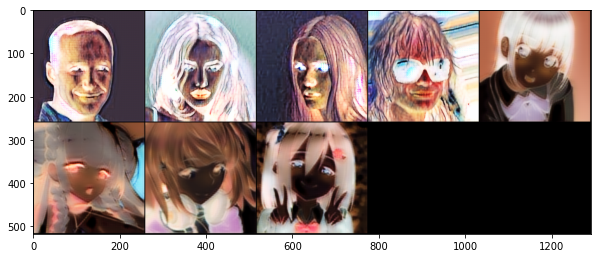

Epoch 0: Step 400: Generator (U-Net) loss: 3.4081560891866682, Discriminator loss: 0.19185858333483338


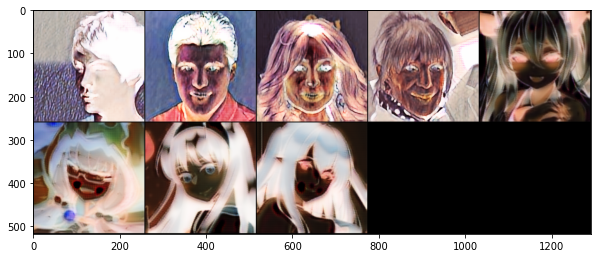

Epoch 0: Step 800: Generator (U-Net) loss: 3.411615647673604, Discriminator loss: 0.1913574613444508


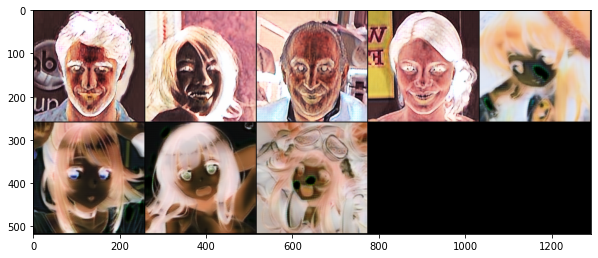

Epoch 0: Step 1200: Generator (U-Net) loss: 3.5134672200679775, Discriminator loss: 0.18828290496021524


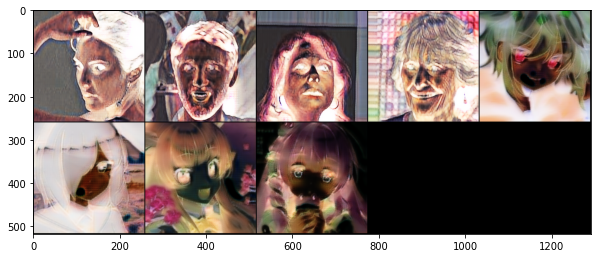

Epoch 1: Step 1600: Generator (U-Net) loss: 3.4568714421987483, Discriminator loss: 0.18592540957033635


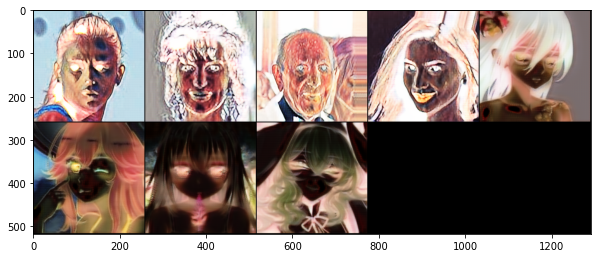

Epoch 1: Step 2000: Generator (U-Net) loss: 3.239707319736479, Discriminator loss: 0.24395694365724904


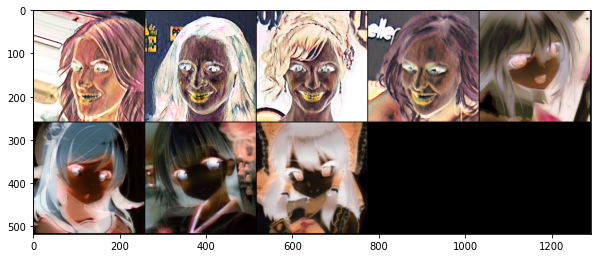

Epoch 1: Step 2400: Generator (U-Net) loss: 3.2543632054328904, Discriminator loss: 0.24961562421172856


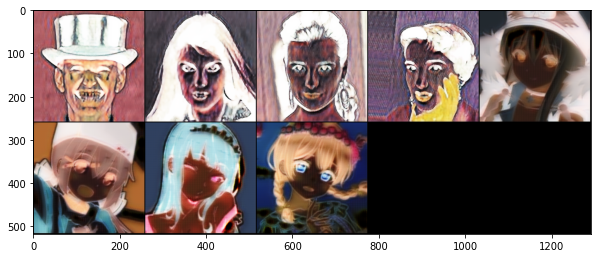

Epoch 2: Step 2800: Generator (U-Net) loss: 3.3104697519540793, Discriminator loss: 0.24758776452392334


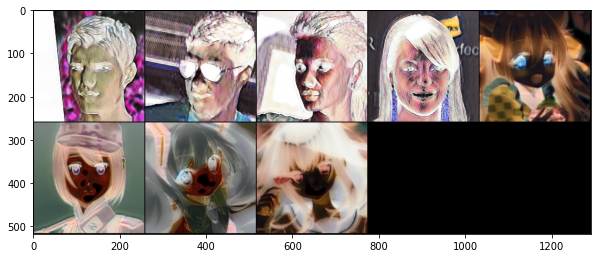

Epoch 2: Step 3200: Generator (U-Net) loss: 3.004353854060173, Discriminator loss: 0.2448081155866384


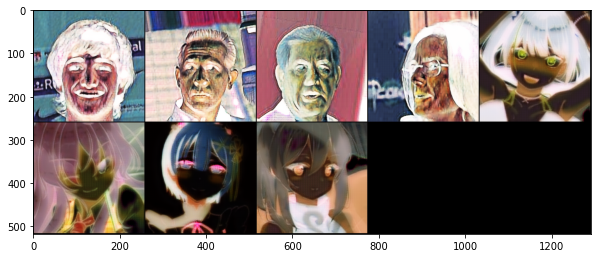

Epoch 2: Step 3600: Generator (U-Net) loss: 2.8030828583240526, Discriminator loss: 0.2430394608527422


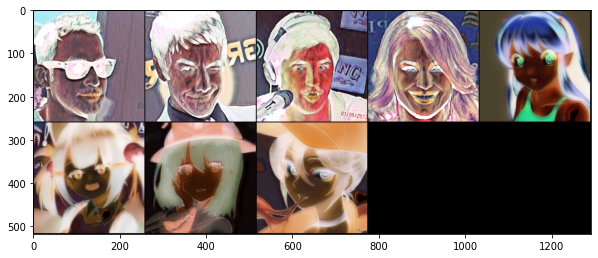

Epoch 3: Step 4000: Generator (U-Net) loss: 2.839278517961503, Discriminator loss: 0.23708509631454952


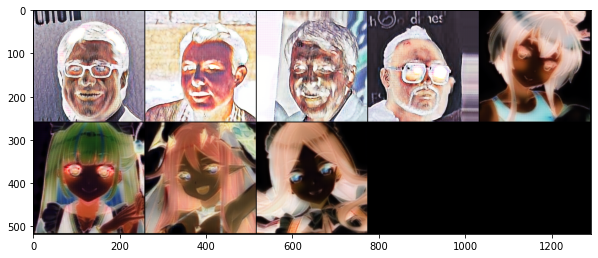

Epoch 3: Step 4400: Generator (U-Net) loss: 2.830845305919647, Discriminator loss: 0.2290936537832023


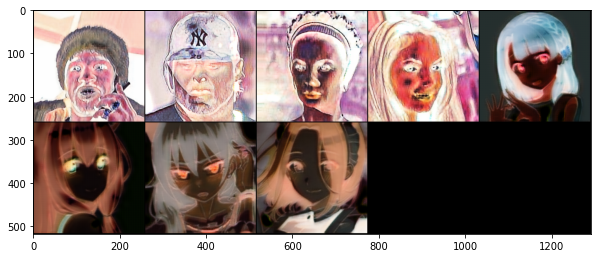

Epoch 3: Step 4800: Generator (U-Net) loss: 3.005836212635041, Discriminator loss: 0.1998116244748235


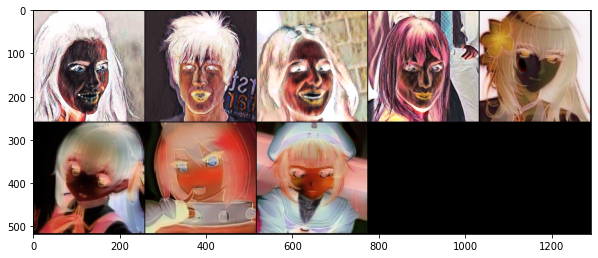

Epoch 4: Step 5200: Generator (U-Net) loss: 3.081033160090447, Discriminator loss: 0.18730585757642995


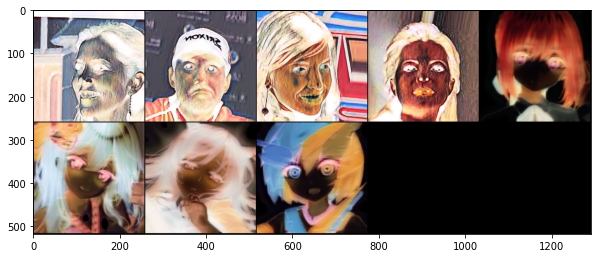

Epoch 4: Step 5600: Generator (U-Net) loss: 2.7474055880308152, Discriminator loss: 0.2849459120631218


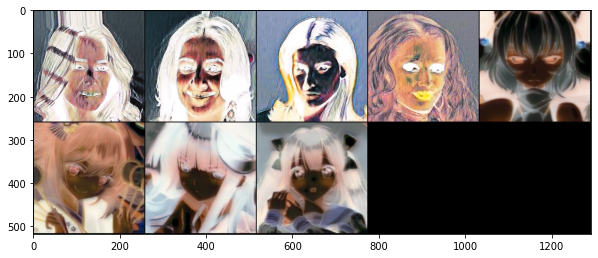

Epoch 4: Step 6000: Generator (U-Net) loss: 2.84138359129429, Discriminator loss: 0.2480022639781236


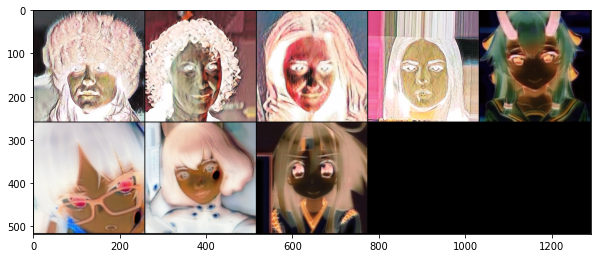

Epoch 5: Step 6400: Generator (U-Net) loss: 2.8121360474824906, Discriminator loss: 0.24788302473723886


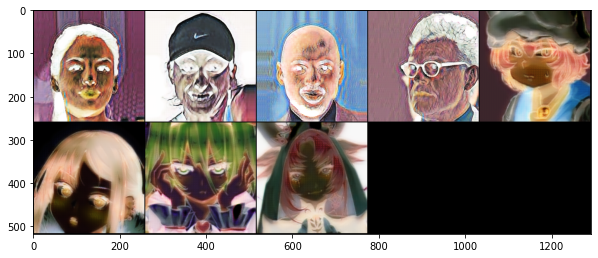

Epoch 5: Step 6800: Generator (U-Net) loss: 3.043008269071577, Discriminator loss: 0.24718843646347508


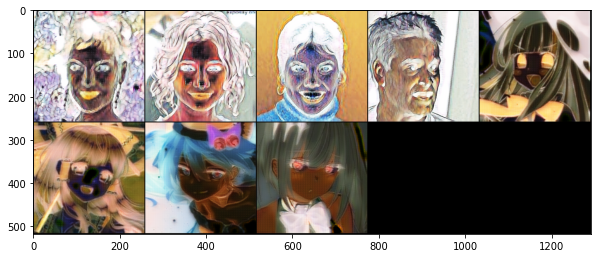

Epoch 5: Step 7200: Generator (U-Net) loss: 2.6214388352632505, Discriminator loss: 0.24641662072390308


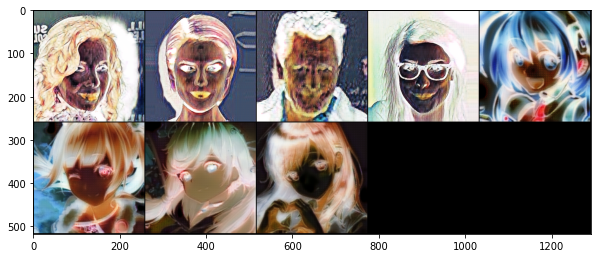

Epoch 6: Step 7600: Generator (U-Net) loss: 3.0363764160871507, Discriminator loss: 0.24621726840734487


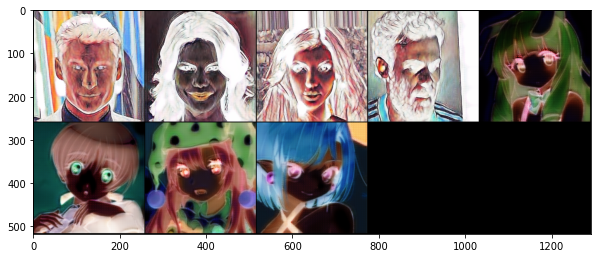

Epoch 6: Step 8000: Generator (U-Net) loss: 2.771737127900122, Discriminator loss: 0.24625499237328763


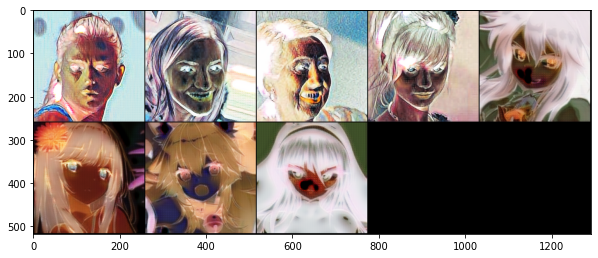

Epoch 6: Step 8400: Generator (U-Net) loss: 2.5374424618482605, Discriminator loss: 0.2439599062129858


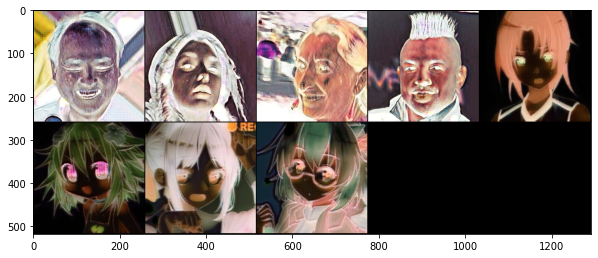

Epoch 7: Step 8800: Generator (U-Net) loss: 2.5093068918585764, Discriminator loss: 0.2422420813515782


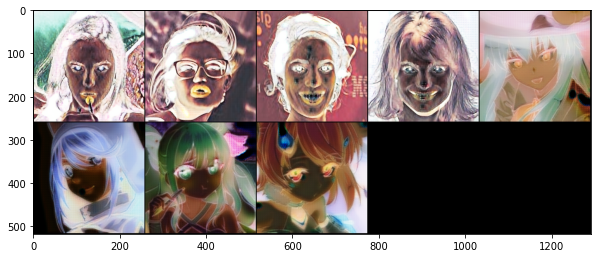

Epoch 7: Step 9200: Generator (U-Net) loss: 2.492721774876118, Discriminator loss: 0.2402354734763502


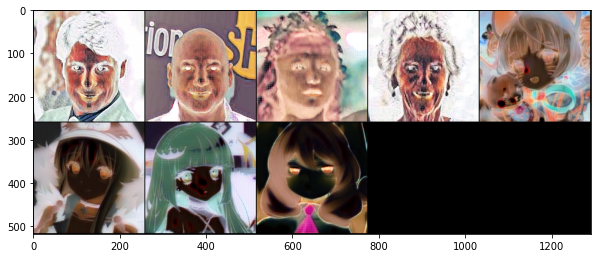

Epoch 7: Step 9600: Generator (U-Net) loss: 2.473944616615773, Discriminator loss: 0.234672365821898


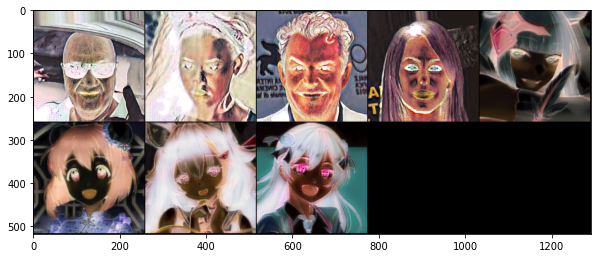

Epoch 8: Step 10000: Generator (U-Net) loss: 2.5047531449794787, Discriminator loss: 0.23294021621346472


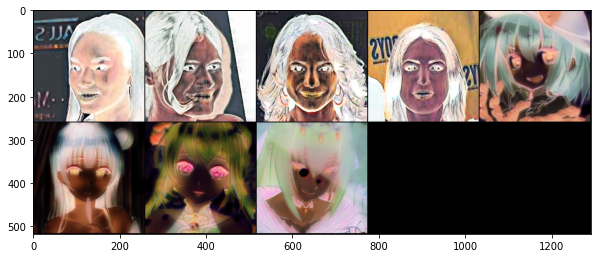

Epoch 8: Step 10400: Generator (U-Net) loss: 2.5087392890453346, Discriminator loss: 0.2295869499817488


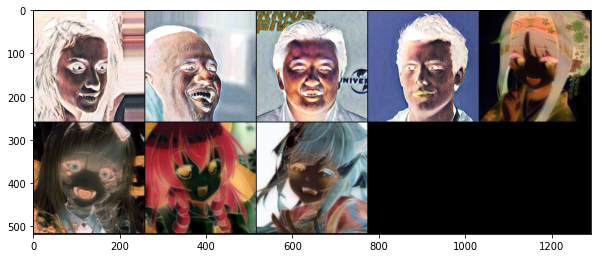

Epoch 8: Step 10800: Generator (U-Net) loss: 2.5190957480669027, Discriminator loss: 0.22900358237326168


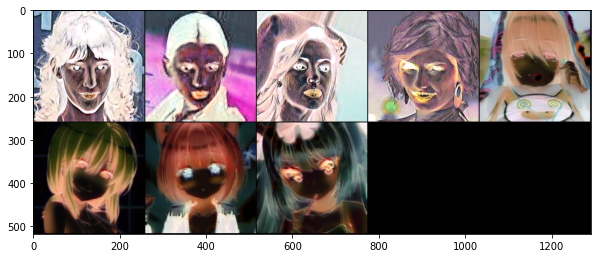

Epoch 8: Step 11200: Generator (U-Net) loss: 2.5503563392162314, Discriminator loss: 0.22042625736445204


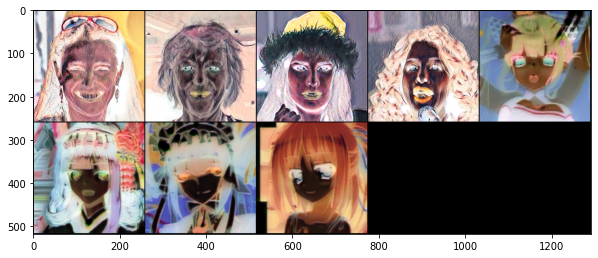

Epoch 9: Step 11600: Generator (U-Net) loss: 2.6140850067138657, Discriminator loss: 0.21497656576335425


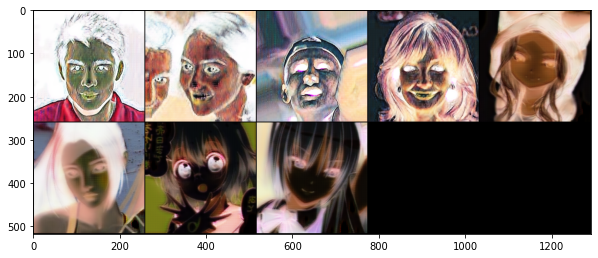

Epoch 9: Step 12000: Generator (U-Net) loss: 2.663225560784339, Discriminator loss: 0.2061128251999617


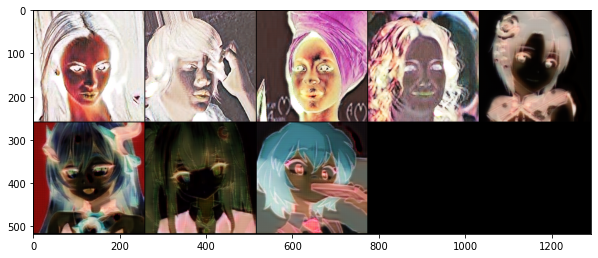

Epoch 9: Step 12400: Generator (U-Net) loss: 2.5940139061212557, Discriminator loss: 0.20205727275460966


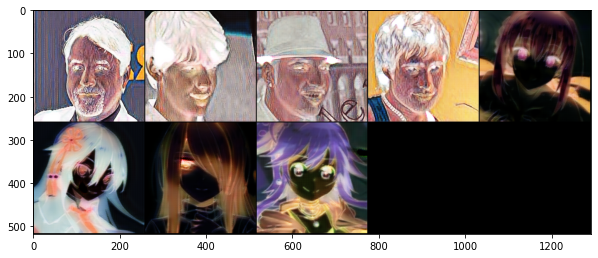

Epoch 10: Step 12800: Generator (U-Net) loss: 2.8073780465126035, Discriminator loss: 0.1958154138736428


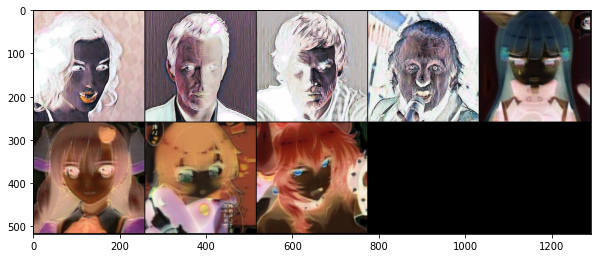

Epoch 10: Step 13200: Generator (U-Net) loss: 2.8712544161081315, Discriminator loss: 0.18531824517995105


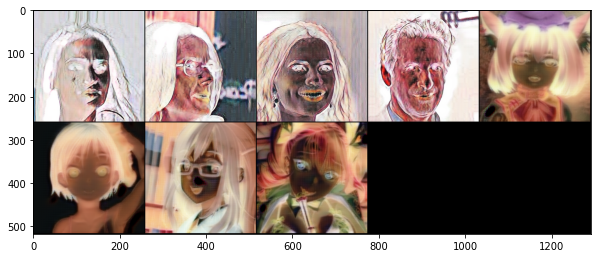

Epoch 10: Step 13600: Generator (U-Net) loss: 2.9455723738670345, Discriminator loss: 0.18065047992393368


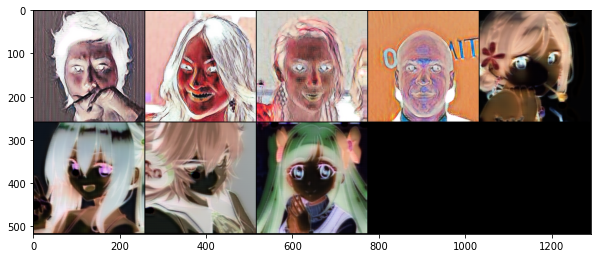

Epoch 11: Step 14000: Generator (U-Net) loss: 2.964075422286988, Discriminator loss: 0.1769798670709135


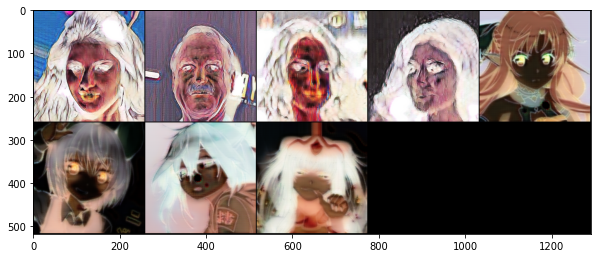

Epoch 11: Step 14400: Generator (U-Net) loss: 2.925293499827384, Discriminator loss: 0.18408595621585835


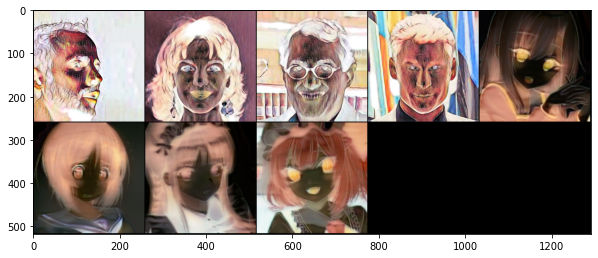

Epoch 11: Step 14800: Generator (U-Net) loss: 2.538268535733224, Discriminator loss: 0.17995099104940895


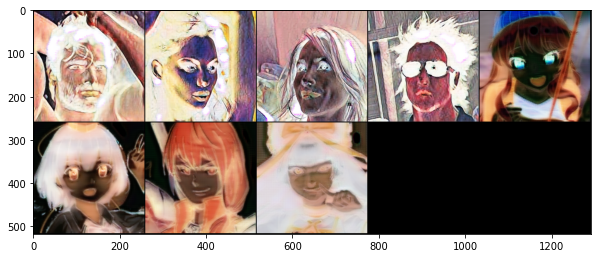

Epoch 12: Step 15200: Generator (U-Net) loss: 2.5977442470192935, Discriminator loss: 0.1782781540974976


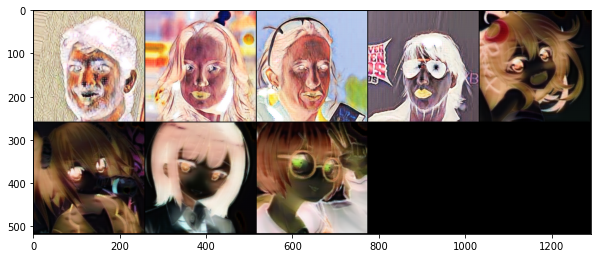

Epoch 12: Step 15600: Generator (U-Net) loss: 2.5468950718641263, Discriminator loss: 0.17956928977742792


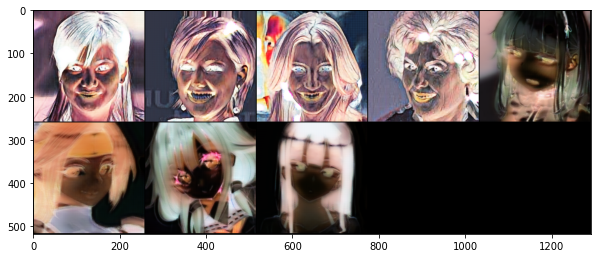

Epoch 12: Step 16000: Generator (U-Net) loss: 2.5502581495046597, Discriminator loss: 0.20962075458839544


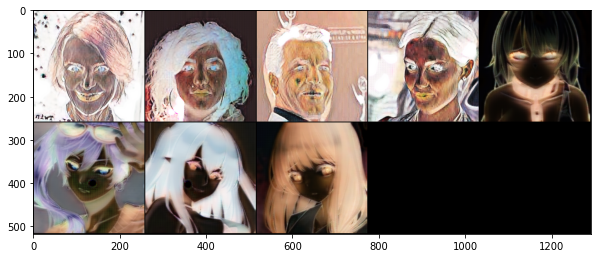

Epoch 13: Step 16400: Generator (U-Net) loss: 2.372509842216967, Discriminator loss: 0.24230928774923088


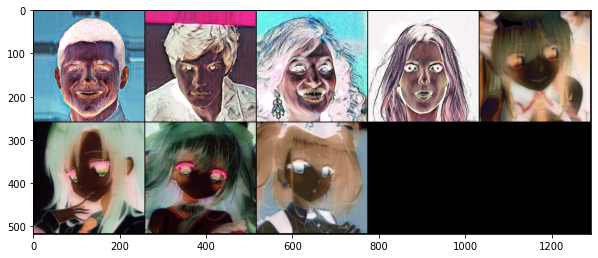

Epoch 13: Step 16800: Generator (U-Net) loss: 2.78786567211151, Discriminator loss: 0.1972121399268508


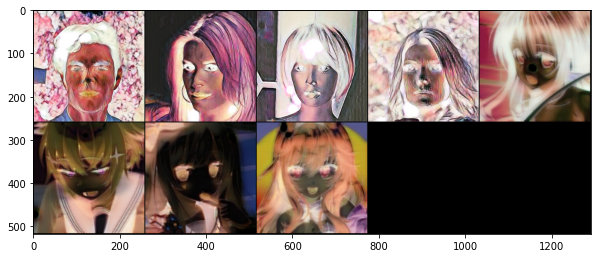

Epoch 13: Step 17200: Generator (U-Net) loss: 2.8991089582443212, Discriminator loss: 0.17362801907584074


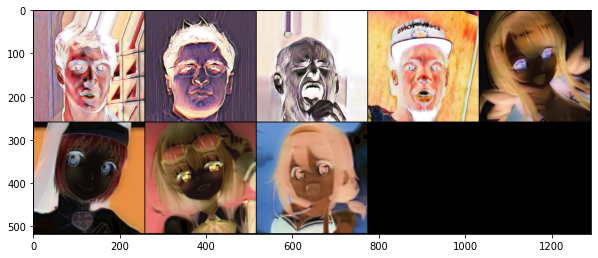

Epoch 14: Step 17600: Generator (U-Net) loss: 2.904239453673364, Discriminator loss: 0.17883760742843133


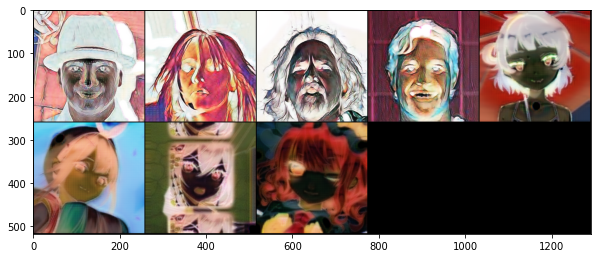

Epoch 14: Step 18000: Generator (U-Net) loss: 2.9889202189445503, Discriminator loss: 0.1726592378690839


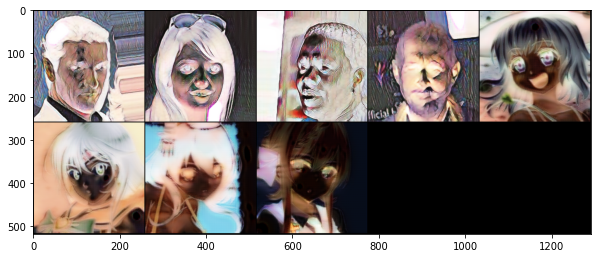

Epoch 14: Step 18400: Generator (U-Net) loss: 3.0307985341548918, Discriminator loss: 0.17388034098781663


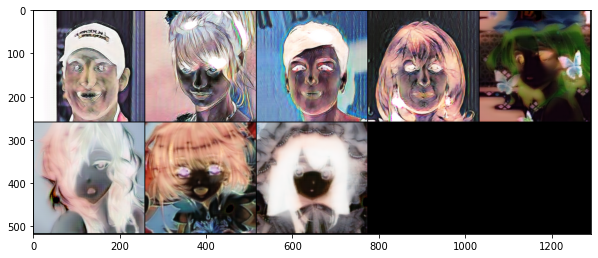

Epoch 15: Step 18800: Generator (U-Net) loss: 2.9459755736589446, Discriminator loss: 0.18188502881675958


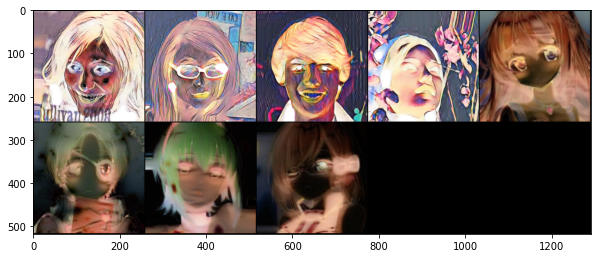

Epoch 15: Step 19200: Generator (U-Net) loss: 2.9203182369470597, Discriminator loss: 0.17653453666716817


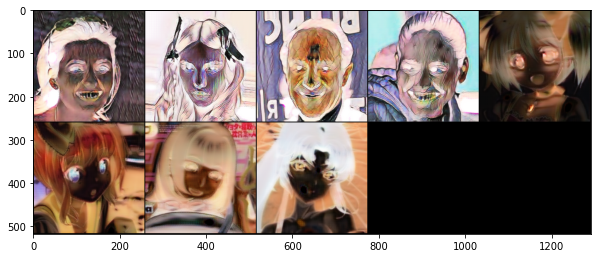

Epoch 15: Step 19600: Generator (U-Net) loss: 3.018682318329813, Discriminator loss: 0.17259646888822308


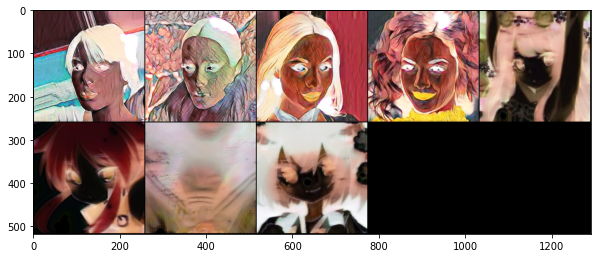

In [ ]:
from skimage import color
import numpy as np
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(log_dir='drive/MyDrive/Projects/anime/logdir4')

plt.rcParams["figure.figsize"] = (10, 10)


def train(save_model=False):
    log_t = 0
    mean_generator_loss = 0
    mean_discriminator_loss = 0
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
    cur_step = 0

    for epoch in range(n_epochs):
        # Dataloader returns the batches
        # for image, _ in tqdm(dataloader):
        for real_A, real_B in tqdm(dataloader):
            # image_width = image.shape[3]
            real_A = nn.functional.interpolate(real_A, size=target_shape)
            real_B = nn.functional.interpolate(real_B, size=target_shape)
            cur_batch_size = len(real_A)
            real_A = real_A.to(device)
            real_B = real_B.to(device)

            ### Update discriminator A ###
            disc_A_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_A = gen_BA(real_B)
            disc_A_loss = get_disc_loss(real_A, fake_A, disc_A, adv_criterion)
            disc_A_loss.backward(retain_graph=True) # Update gradients
            disc_A_opt.step() # Update optimizer

            ### Update discriminator B ###
            disc_B_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_B = gen_AB(real_A)
            disc_B_loss = get_disc_loss(real_B, fake_B, disc_B, adv_criterion)
            disc_B_loss.backward(retain_graph=True) # Update gradients
            disc_B_opt.step() # Update optimizer

            ### Update generator ###
            gen_opt.zero_grad()
            gen_loss, fake_A, fake_B = get_gen_loss(
                real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, recon_criterion, recon_criterion
            )
            gen_loss.backward() # Update gradients
            gen_opt.step() # Update optimizer

            # Keep track of the average discriminator loss
            mean_discriminator_loss += disc_A_loss.item() / display_step
            # Keep track of the average generator loss
            mean_generator_loss += gen_loss.item() / display_step

            ### Visualization code ###
            if cur_step % 100 == 0:
                
                writer.add_scalar("Loss/train_generator", mean_generator_loss, log_t)
                writer.add_scalar("Loss/train_discriminator", mean_discriminator_loss, log_t)
                log_t += 1
            if cur_step % display_step == 0:
                print(f"Epoch {epoch}: Step {cur_step}: Generator (U-Net) loss: {mean_generator_loss}, Discriminator loss: {mean_discriminator_loss}")
                #show_tensor_images(torch.cat([real_A, real_B]), size=(dim_A, target_shape, target_shape))
                show_tensor_images(torch.cat([fake_B, fake_A]), size=(dim_B, target_shape, target_shape))
                mean_generator_loss = 0
                mean_discriminator_loss = 0
                # You can change save_model to True if you'd like to save the model
            if cur_step % saving_step == 0:
                if save_model:
                    torch.save({
                        'gen_AB': gen_AB.state_dict(),
                        'gen_BA': gen_BA.state_dict(),
                        'gen_opt': gen_opt.state_dict(),
                        'disc_A': disc_A.state_dict(),
                        'disc_A_opt': disc_A_opt.state_dict(),
                        'disc_B': disc_B.state_dict(),
                        'disc_B_opt': disc_B_opt.state_dict()
                    }, f"drive/MyDrive/Projects/anime/model_new/cycleGAN_{cur_step}.pth")
            cur_step += 1

train(True)
writer.flush()
writer.close()

In [ ]:
!pip install tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir='drive/MyDrive/Projects/anime/logdir1'

<IPython.core.display.Javascript object>

In [ ]:
# memory footprint support libraries/code
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install gputil
!pip install psutil
!pip install humanize

import psutil
import humanize
import os
import GPUtil as GPU

  Created wheel for gputil: filename=GPUtil-1.4.0-cp37-none-any.whl size=7411 sha256=671b8ad44d244163e076f733e4fd8f9ae82c1a66b3d43eb9c20bea8071815a36
  Stored in directory: /root/.cache/pip/wheels/3d/77/07/80562de4bb0786e5ea186911a2c831fdd0018bda69beab71fd
Successfully built gputil


In [ ]:
GPUs = GPU.getGPUs()
# XXX: only one GPU on Colab and isn’t guaranteed
gpu = GPUs[0]
def printm():
    process = psutil.Process(os.getpid())
    print("Gen RAM Free: " + humanize.naturalsize(psutil.virtual_memory().available), " |     Proc size: " + humanize.naturalsize(process.memory_info().rss))
    print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total     {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
printm()

NameError: ignored